# **Building Music Recommendation System**

In [2]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
import scipy.sparse.linalg

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist


import warnings
warnings.filterwarnings("ignore")

# **Read Data**

In [3]:
data = pd.read_csv("ML_Project/data/data.csv")
genre_data = pd.read_csv('ML_Project/data/data_by_genres.csv')
year_data = pd.read_csv('ML_Project/data/data_by_year.csv')

In [4]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [5]:
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [6]:
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


We are going to check for all the analysis with the target as **'popularity'**. Also, we will check Feature Correlation by considering a few features by using **yellowbrick** package. Ref:(https://www.scikit-yb.org/en/latest/index.html).

In [7]:
pip install yellowbrick

Note: you may need to restart the kernel to use updated packages.


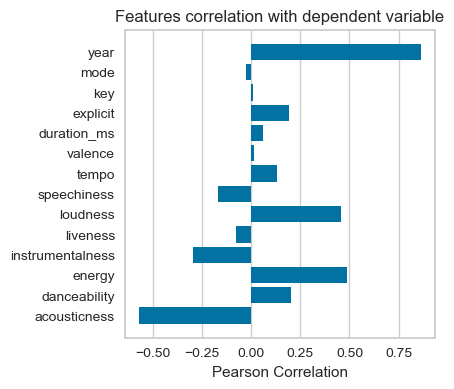

<AxesSubplot:title={'center':'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [8]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
plt.figure(figsize =(4, 4))
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

# **Music Over Time**

Using the data grouped by year, we can understand how the overall sound of music has changed from 1921 to 2020.

<AxesSubplot:xlabel='years', ylabel='count'>

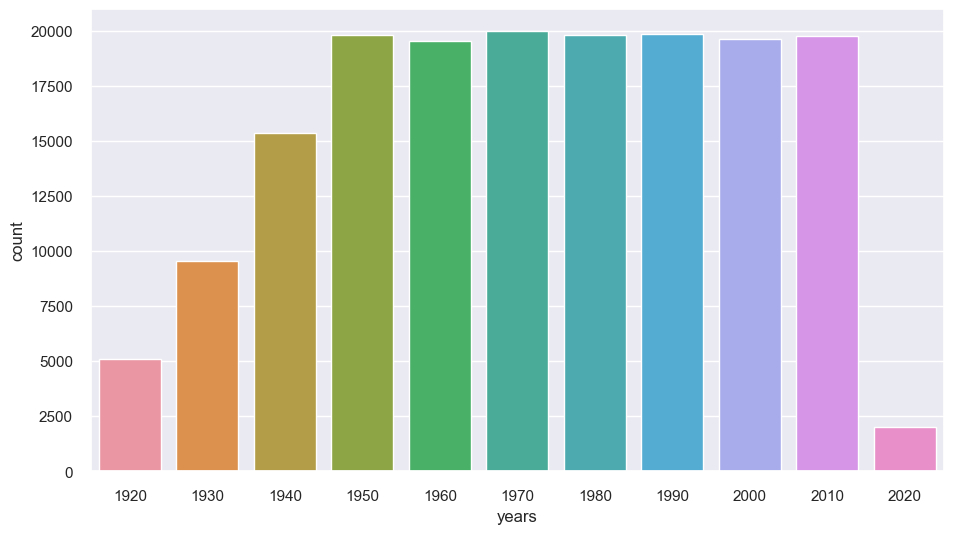

In [9]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
decade= pd.DataFrame(np.char.strip(np.array(data['decade'],dtype='<U5'),'s').astype(np.int16)).rename(columns={0: 'years'})
#sns.countplot(pd.DataFrame(data['decade']))
# print(np.char.strip(np.array(data['decade'],dtype='<U5'),'s').astype(np.int32))
sns.countplot(data = decade,x='years')

In [10]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

# **Characteristics of Different Genres**

Genre dataset contains the audio features for different songs along with the other audio features for different genres. We used this information to compare different genres and understand their unique differences in sound.

In [11]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

# **Clustering Genres with K-Means**

K-means clustering algorithm is used to divide the genres in the dataset but before that Elbow method is used to identify number of clusters.

In [12]:
def elbow(iterations,chosen):
    distortions = []
    inertias = []
    mapping1 = {}
    mapping2 = {}
    K = range(1, iterations)

    for k in K:
        # Building and fitting the model
        kmeanModel = KMeans(n_clusters=k).fit(chosen)
        kmeanModel.fit(chosen)

        distortions.append(sum(np.min(cdist(chosen, kmeanModel.cluster_centers_,
                                            'euclidean'), axis=1)) / chosen.shape[0])
        inertias.append(kmeanModel.inertia_)

        mapping1[k] = sum(np.min(cdist(chosen, kmeanModel.cluster_centers_,
                                       'euclidean'), axis=1)) / chosen.shape[0]
        mapping2[k] = kmeanModel.inertia_

    plt.plot(K, distortions, 'bx-')
    plt.xlabel('Values of K')
    plt.ylabel('Distortion')
    plt.title('The Elbow Method using Distortion')
    plt.show()

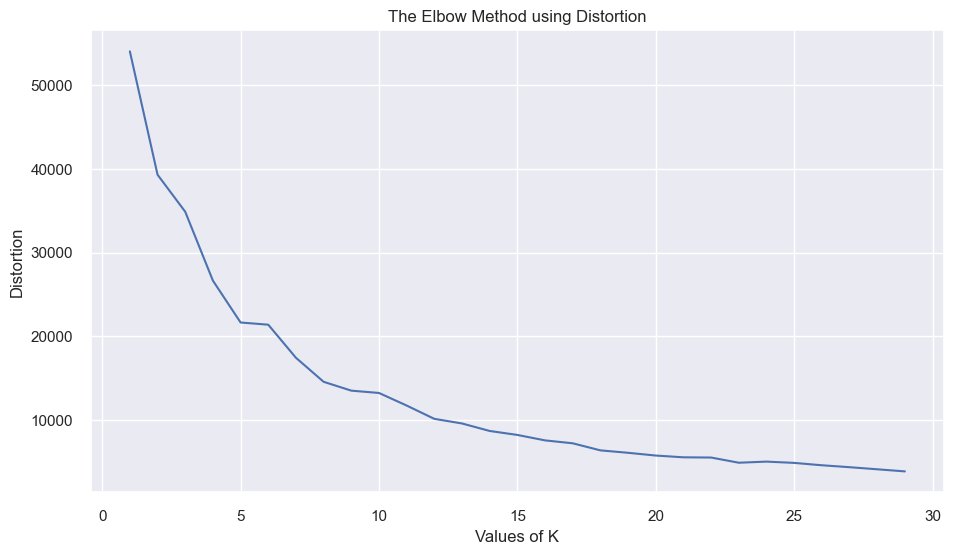

In [13]:
elbow(30,genre_data[['acousticness','danceability','duration_ms','energy','instrumentalness','liveness','loudness','speechiness','tempo','valence','popularity']])

In [14]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [15]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.010s...
[t-SNE] Computed neighbors for 2973 samples in 0.468s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.117683
[t-SNE] KL divergence after 1000 iterations: 1.387957


# **Clustering Songs with K-Means**

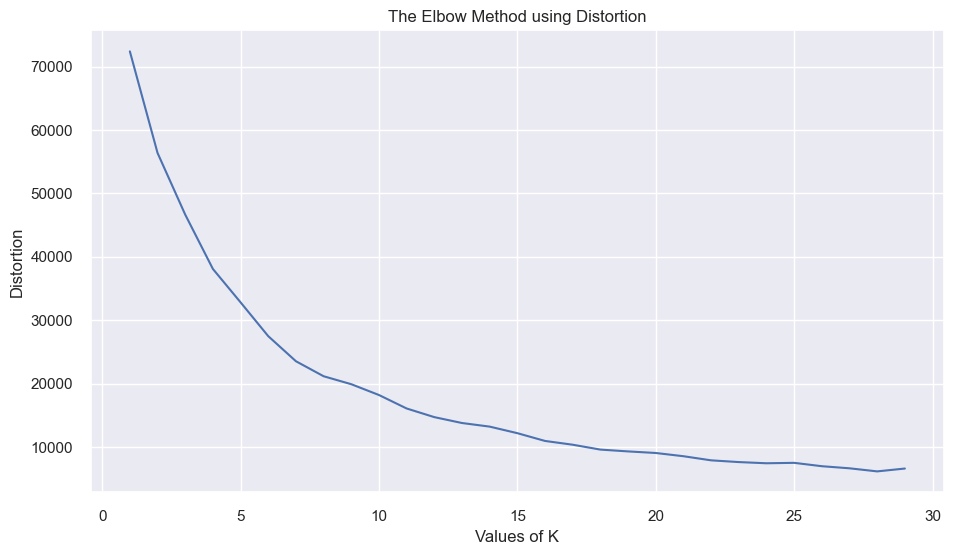

In [16]:
elbow(30,data[['acousticness','danceability','duration_ms','energy','instrumentalness','liveness','loudness','speechiness','tempo','valence','popularity']])

In [17]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [18]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# **To build a Recommendation System**

* Based on the analysis and visualizations, it’s clear that similar genres tend to have data points that are located close to each other while similar types of songs are also clustered together.
* Similar genres will sound similar and will come from similar time periods while the same can be said for songs within those genres. This concept is used to build a recommendation system by taking the data points of the songs a user has listened to and recommending songs corresponding to nearby data points.

In [19]:
pip install spotipy

Note: you may need to restart the kernel to use updated packages.


In [20]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id='36abe079d2264e4194efa631e0f26848',
                                                           client_secret='975924513d334eada7797743a91023f4'))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1,type='track')
    if results['tracks']['items'] == []:
        return None
    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]
    
    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value
    return pd.DataFrame(song_data)

In [21]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            raise Exception('Warning: {} does not exist in Spotify or in database'.format(song['name']))
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    try:
        metadata_cols = ['name', 'year', 'artists']
        song_dict = flatten_dict_list(song_list)
        
        song_center = get_mean_vector(song_list, spotify_data)
        scaler = song_cluster_pipeline.steps[0][1]
        scaled_data = scaler.transform(spotify_data[number_cols])
        scaled_song_center = scaler.transform(song_center.reshape(1, -1))
        distances = cdist(scaled_song_center, scaled_data, 'cosine')
        index = list(np.argsort(distances)[:, :n_songs][0])
        
        rec_songs = spotify_data.iloc[index]
        rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
        return rec_songs[metadata_cols].to_dict(orient='records')
    except Exception as e:
        return e

In [22]:
pip install sv-ttk

Note: you may need to restart the kernel to use updated packages.


In [ ]:
from tkinter import ttk
from tkinter import *
import sv_ttk

class Music_Recommendation:

    def __init__(self, window):
        
        self.wind = window
        self.wind.title('Music Recommendation System')

        
        frame = LabelFrame(self.wind, text = 'Start !!!')
        frame.grid(row = 0, column = 0, columnspan = 3, pady = 20)

       
        Label(frame, text = 'Name: ').grid(row = 1, column = 0)
        self.name = Entry(frame)
        self.name.focus()
        self.name.grid(row = 1, column = 1)

        
        Label(frame, text = 'year: ').grid(row = 2, column = 0)
        self.year = Entry(frame)
        self.year.grid(row = 2, column = 1)

        
        ttk.Button(frame, text = 'Look for recommendations', command = self.send_to_model).grid(row = 3, columnspan = 2, sticky = W + E)

        
        self.message = Label(text = '', fg = 'red')
        self.message.grid(row = 3, column = 0, columnspan = 2, sticky = W + E)

        
        self.tree = ttk.Treeview(height = 10, columns = ("#1","#2"))
        self.tree.grid(row = 4, column = 0, columnspan = 4)
        self.tree.heading('#0', text = 'Name', anchor = CENTER)
        self.tree.heading('#1', text = 'Year', anchor = CENTER)
        self.tree.heading('#2', text = 'art', anchor = CENTER)

   
    def show_recommendations(self,recommendations):
        # cleaning Table 
        records = self.tree.get_children()
        for element in records:
            self.tree.delete(element)
        for row in recommendations:
            print(row)
            self.tree.insert('', 0,text = row['name'], values=( row['year'], row['artists']))

   
    def validation(self):
        return len(self.name.get()) != 0 and len(self.year.get()) != 0

    def send_to_model(self):
        self.message['text'] = ''
        self.message['fg'] = 'red'
        if self.validation():
            recommendations = recommend_songs([{'name': self.name.get(), 'year':int(self.year.get())}],data)
            self.show_recommendations(recommendations)
            self.message['fg'] = 'green'
            self.message['text'] = f"showing results for name : {self.name.get()} , year : {self.year.get()}"
            self.name.delete(0, END)
            self.year.delete(0, END)
        else:
            self.message['text'] = 'Name and year is Required'
        

    
if __name__ == '__main__':
    window = Tk()
    application = Music_Recommendation(window)
    window.mainloop()
   

{'name': 'Burn', 'year': 2000, 'artists': "['Jo Dee Messina']"}
{'name': 'Blossom', 'year': 1993, 'artists': "['Candlebox']"}
{'name': 'Inside Of Love', 'year': 2003, 'artists': "['Nada Surf']"}
{'name': 'Real Love - Anthology 2 Version', 'year': 1996, 'artists': "['The Beatles']"}
{'name': 'MEIN LAND', 'year': 2011, 'artists': "['Rammstein']"}
{'name': 'Seasons of Wither', 'year': 2002, 'artists': "['Aerosmith']"}
{'name': 'Pistola', 'year': 2004, 'artists': "['Incubus']"}
{'name': 'Still Unbroken', 'year': 2009, 'artists': "['Lynyrd Skynyrd']"}
{'name': 'I Got', 'year': 2011, 'artists': "['Young the Giant']"}
{'name': 'Living In A Dream', 'year': 1992, 'artists': "['Arc Angels']"}
{'name': 'String Quartet, Op. 1', 'year': 1962, 'artists': "['Glenn Gould', 'SYMPHONIA QUARTET']"}
{'name': 'Symphony No. 2 in C Minor "Resurrection": V. Finale. Im Tempo des Scherzos', 'year': 1964, 'artists': "['Gustav Mahler', 'Leonard Bernstein', 'New York Philharmonic']"}
{'name': 'Symphony No. 9 in D 

# PROJECT REPORT #

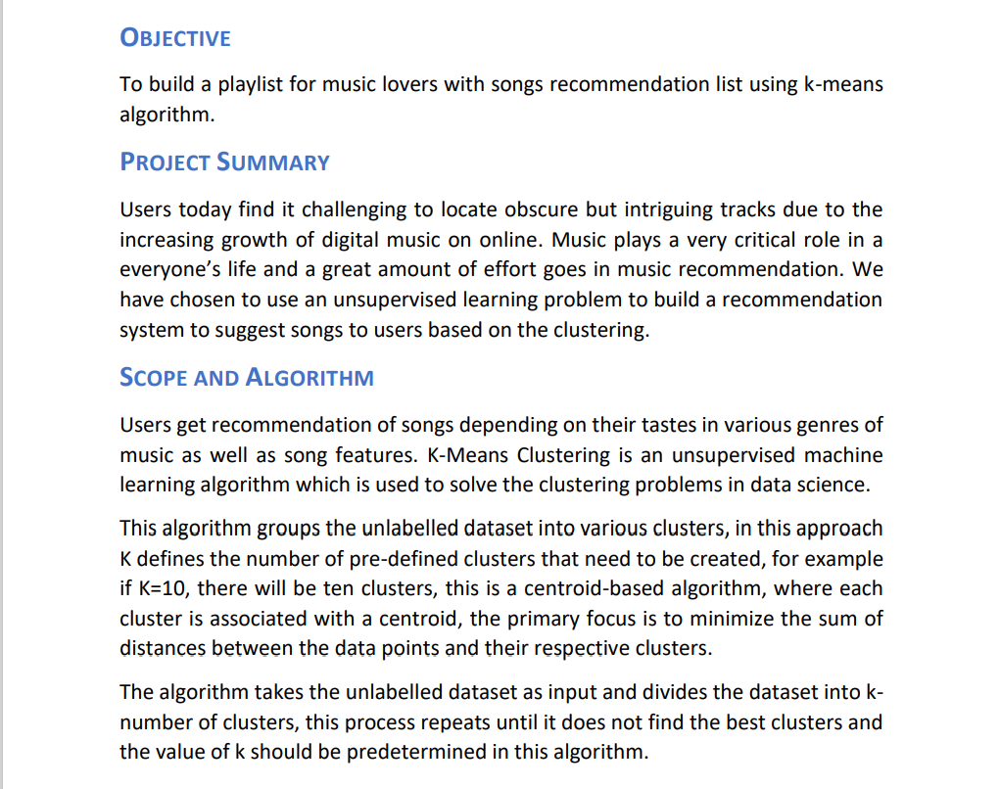

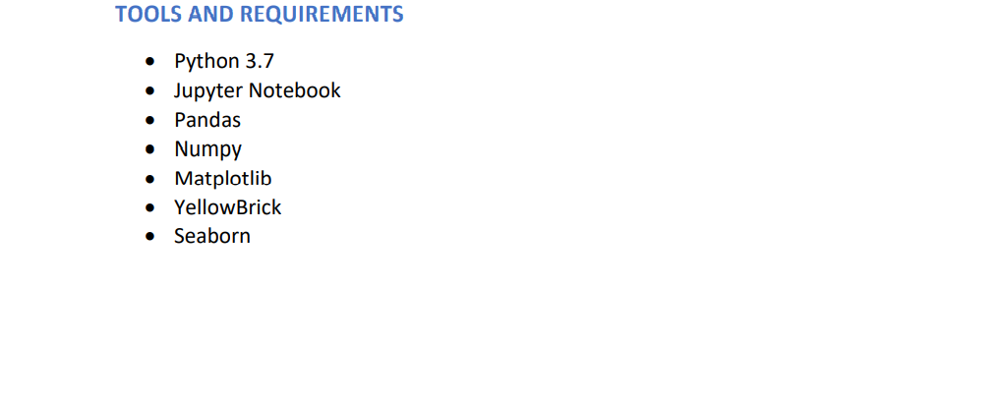

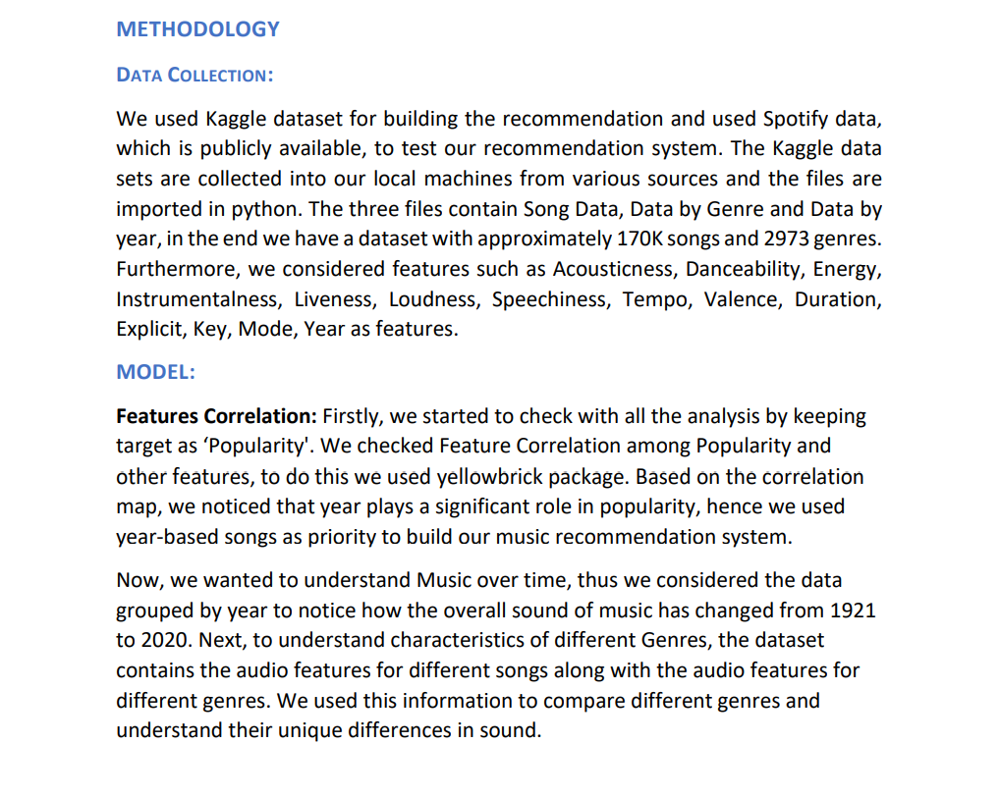

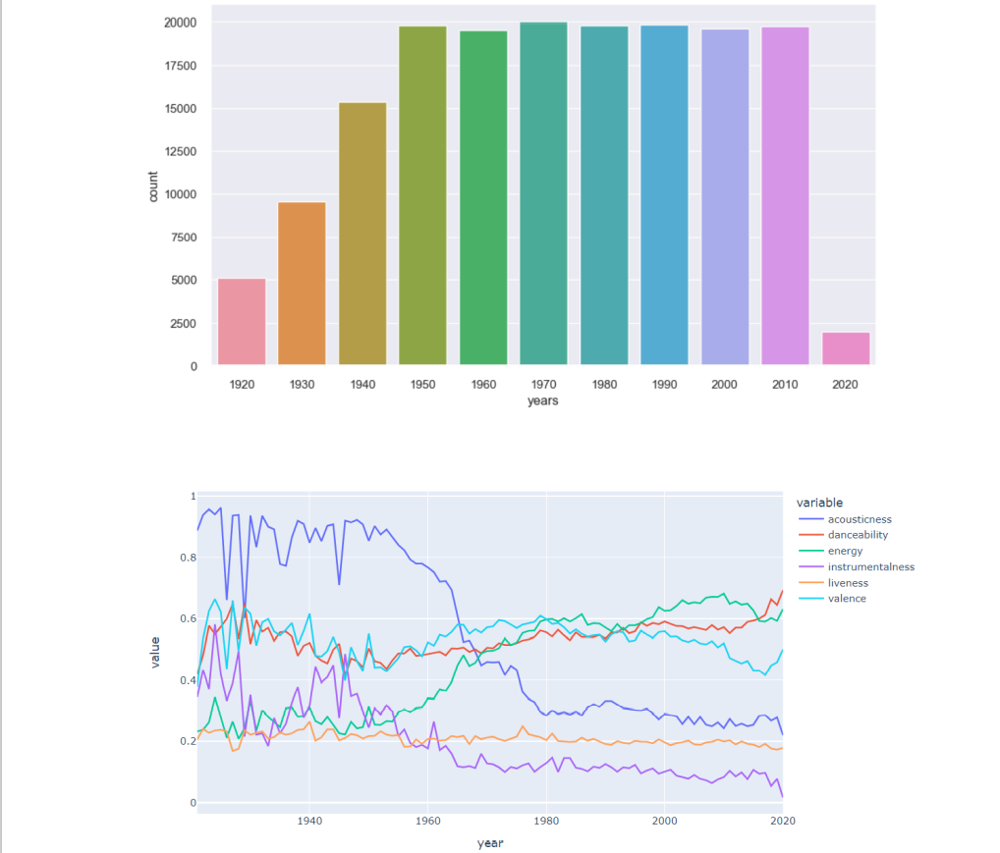

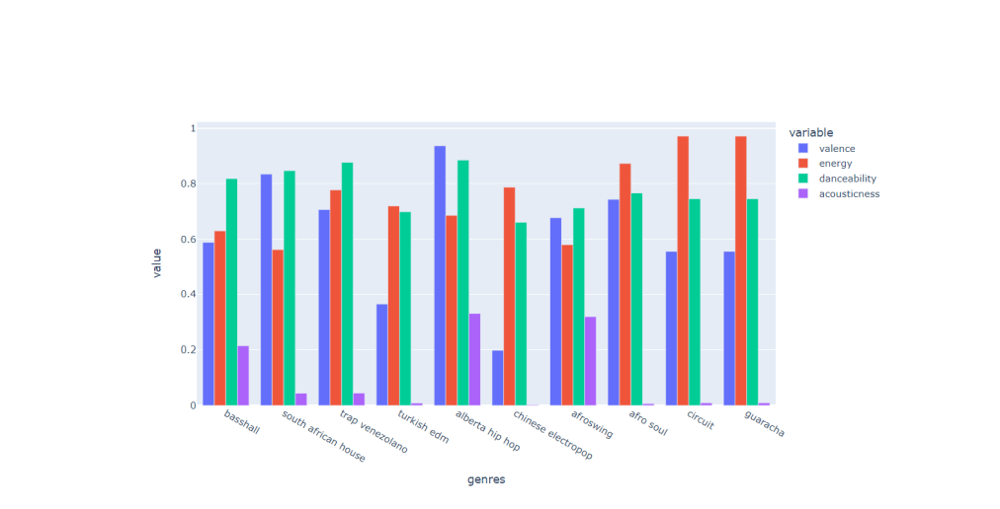

...

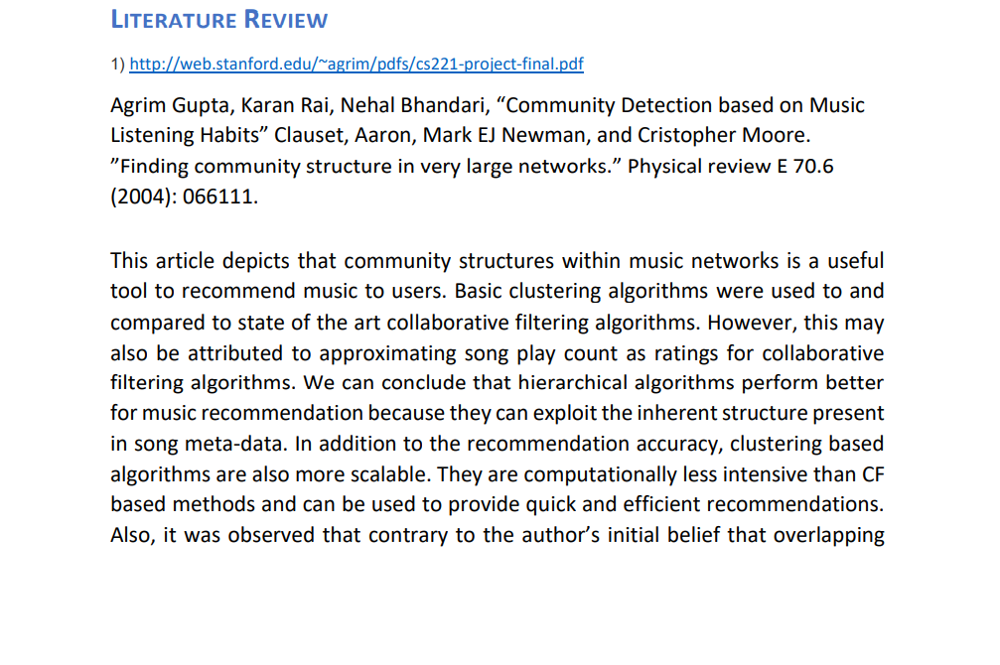

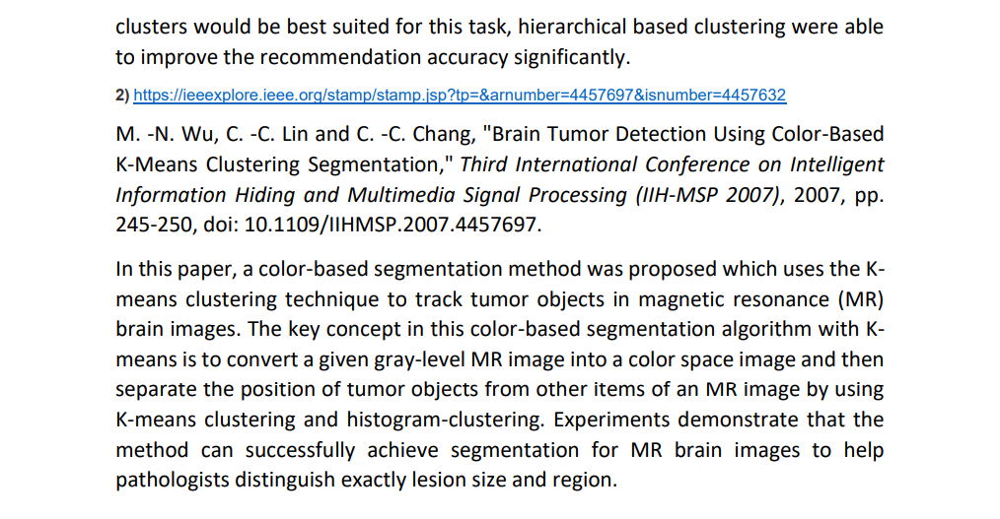

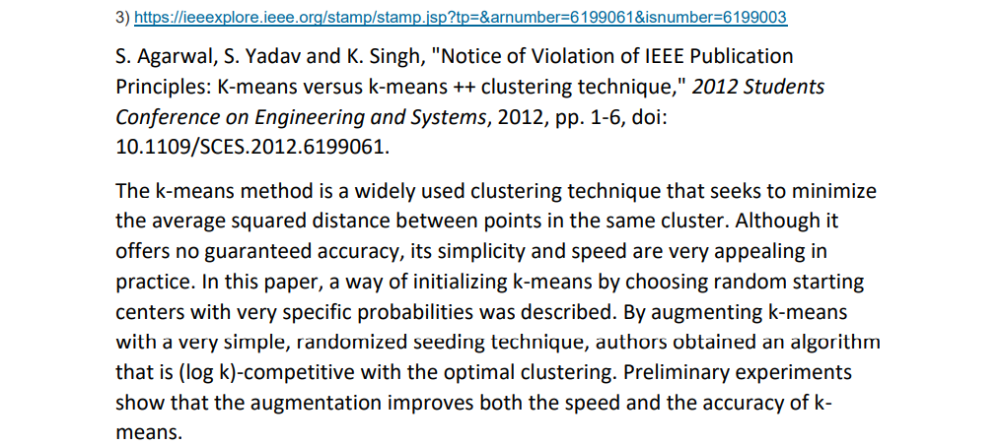

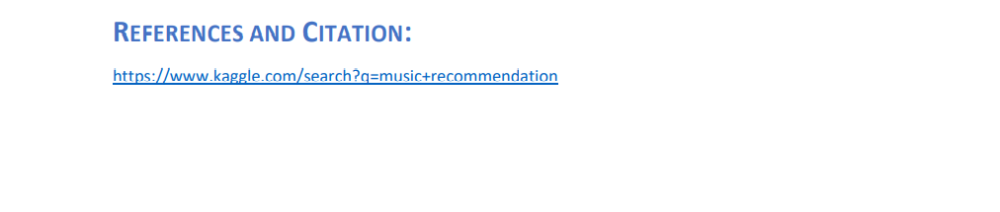

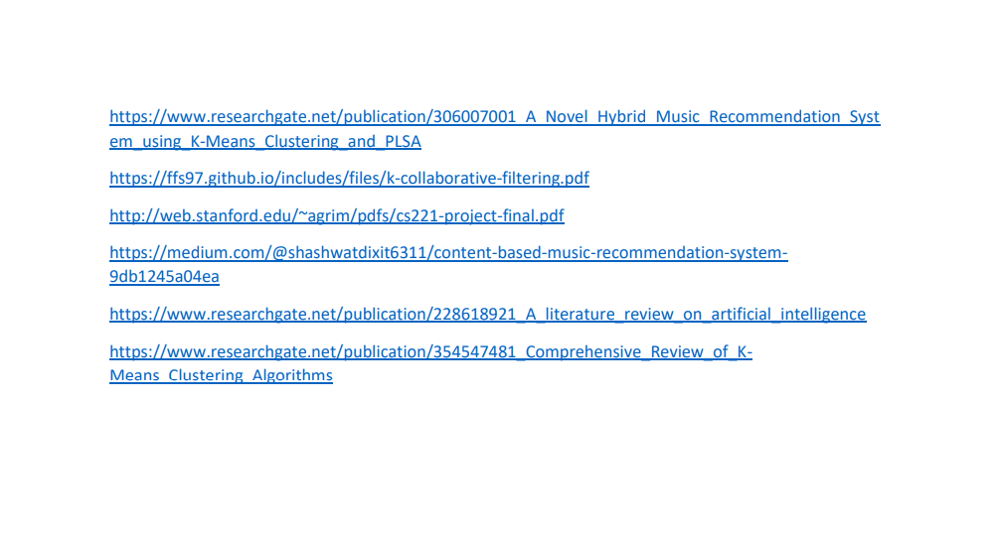